# Data Exploratory 

## Section 1 : Presenting the Data

#### General Information
The following Dataset provides information about the NBA players from 1995 to 2024 included. There is no sampling made.

#### Information on the Variable.


| Name | Description | Type | Levels/range | Process |
| --- | --- | --- | --- | --- | 
| Player | --- | Categorical | 2755 Levels | RAW | 
| Team | --- | Categoricals | 43 Levels | --- | 
| Points | --- | Numerical Discrete | >=0 | Count | 
| Pos | Position | Categorical | PG,SG,SF,PF,C | RAW | 
| G | Game Played | Numerical Discrete | >=0 | Count | 
| GS | Game Started | Numerical Discrete | >=0 | Count | 
| MP | Minutes Played | Numerical Continuous | >=0 | Count | 
| FG | Fields Goal Count (Excludes Free shots) | Numerical Discrete | >=0 | Count | 
| FGA | Field Goal Attempt | Numerical Discrete | >=0 | Count | 
| FG% | Field Goal Ratio | Numerical Continuous | Between 0 & 1 | FG/FGA | 
| 3P | 3 points Field Goal  | Numerical Discrete | >=0 | Count |
| 3PA | 3 point Field Goal Attempts | Numerical Discrete | >=0 | Count |
| 3P% | 3 point Field Goal Ratio | Numerical Continuous | Between 0 & 1 | 3P/3PA |
| 2P | 2 points Field Goal  | Numerical Discrete | >=0 | Count |
| 2PA | 2 point Field Goal Attempts | Numerical Discrete | >=0 | Count |
| 2P% | 2 point Field Goal Ratio | Numerical Continuous | Between 0 & 1 | 2P/2PA | 
| eFG% | Effective Field Goal | Numerical Continuous | Between 0 and 1 | (FG + 0.5 * 3P) / FGA | 
| FT | Free Throws | Numerical Discrete | >=0 | Count | 
| FTA | Free Throws Attempts | Numerical Discrete | >=0 | Count | 
| FT% | Free Throws Ratio | Numerical Continuous | Between 0 & 1 | FT/FTA |
| ORB |  Offensive rebounds | Numerical Discrete | >=0 | Count | 
| DRB | Defensive rebounds | Numerical Discrete | >=0 | Count | 
| TRB | Total rebounds | Numerical Discrete | >=0 | DRP+ORB | 
| AST | Assists | Numerical Discrete | >=0 | Count | 
| STL | Steals | Numerical Discrete | >=0 | Count | 
| BLK | Blocks | Numerical Discrete | >=0 | Count | 
| TOV | Turnovers | Numerical Discrete | >=0 | Count | 
| PF | Personnal Fouls | Numerical Discrete | >=0 | Count | 
| Trp-Dbl | At least 10 in 3 Distinct statistical categories in one game
 | Numerical Discrete | >=0 | Count |
| Season | Tournament Year | Numerical Discrete | Between 1995 and 2024 | RAW | 



More information on a few variables : 

- ORB & DRB : Offensive rebounds (When the the ball become available after an unsuccessful goal) Offensive : The attackers pick it up 

- eFG% : Effective Field Goal Percentage (Adjusts for 3 points Goals)

- TOV : Turnovers (loose of possession to oposite team)

## Section 2 : Information on the DataSet 

In [1]:
import pandas as pd
import scipy.stats as st
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [2]:
df = pd.read_csv("nba_player_stats_C_Rami.csv")
df.head(3)

,Player,Team,Points,Pos,G,GS,MP,FG,FGA,FG%,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,Trp-Dbl,Season
0,Luka Dončić,DAL,2370.0,PG,70.0,70.0,2624.0,804.0,1652.0,0.487,...,59.0,588.0,647.0,686.0,99.0,38.0,282.0,149.0,21.0,2024
1,Shai Gilgeous-Alexander,OKC,2254.0,PG,75.0,75.0,2553.0,796.0,1487.0,0.535,...,65.0,350.0,415.0,465.0,150.0,67.0,162.0,184.0,0.0,2024
2,Giannis Antetokounmpo,MIL,2222.0,PF,73.0,73.0,2567.0,837.0,1369.0,0.611,...,196.0,645.0,841.0,476.0,87.0,79.0,250.0,210.0,10.0,2024


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17813 entries, 0 to 17812
Data columns (total 29 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Player   17813 non-null  object 
 1   Team     17783 non-null  object 
 2   Points   17783 non-null  float64
 3   Pos      17783 non-null  object 
 4   G        17783 non-null  float64
 5   GS       17783 non-null  float64
 6   MP       17783 non-null  float64
 7   FG       17783 non-null  float64
 8   FGA      17783 non-null  float64
 9   FG%      17705 non-null  float64
 10  3P       17783 non-null  float64
 11  3P.1     15235 non-null  float64
 12  2P       17783 non-null  float64
 13  2PA      17783 non-null  float64
 14  2P%      17627 non-null  float64
 15  eFG%     17705 non-null  float64
 16  FT       17783 non-null  float64
 17  FTA      17783 non-null  float64
 18  FT%      16895 non-null  float64
 19  ORB      17783 non-null  float64
 20  DRB      17783 non-null  float64
 21  TRB      177

In [4]:
df.isnull().sum()

Player        0
Team         30
Points       30
Pos          30
G            30
GS           30
MP           30
FG           30
FGA          30
FG%         108
3P           30
3P.1       2578
2P           30
2PA          30
2P%         186
eFG%        108
FT           30
FTA          30
FT%         918
ORB          30
DRB          30
TRB          30
AST          30
STL          30
BLK          30
TOV          30
PF           30
Trp-Dbl      31
Season        0
dtype: int64

We decide to remove players who don't have a Team.

We will not remove outliers as they underline the unexpected performance of some NBA players

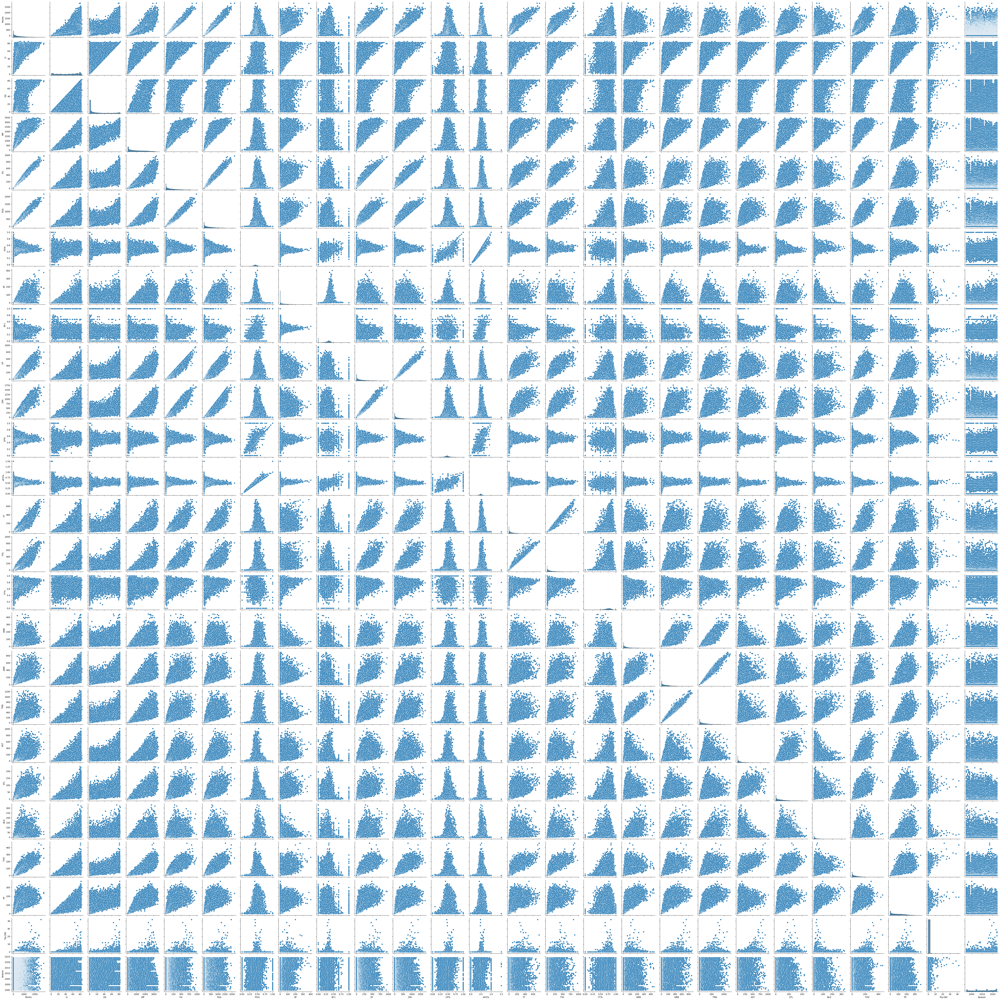

In [5]:
sns.pairplot(df)